# Visualisation of NYC Green Taxi Dataset

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams 
import seaborn as sns
%matplotlib inline 

In [30]:
# Import raw data 
df = pd.read_csv('../data/raw/2015_Green_Taxi_Trip_Data_August.csv')
df.head()

,vendorid,pickup_datetime,dropoff_datetime,Store_and_fwd_flag,rate_code,Pickup_longitude,Pickup_latitude,Dropoff_longitude,Dropoff_latitude,Passenger_count,...,Fare_amount,Extra,MTA_tax,Tip_amount,Tolls_amount,Ehail_fee,Improvement_surcharge,Total_amount,Payment_type,Trip_type
0,2,08/29/2015 05:16:18 PM,08/29/2015 05:23:48 PM,N,1,-73.945724,40.790169,-73.949188,40.805187,1,...,8.0,0.0,0.5,0.00,0.0,NaN,0.3,8.80,1,1.0
1,2,08/28/2015 08:05:28 PM,08/28/2015 08:15:25 PM,N,1,-73.963860,40.710258,-73.950157,40.683243,1,...,9.5,0.5,0.5,2.16,0.0,NaN,0.3,12.96,1,1.0
2,1,08/01/2015 01:07:39 PM,08/01/2015 01:21:50 PM,N,1,-73.968422,40.632347,-74.007500,40.646156,1,...,12.0,0.0,0.5,2.55,0.0,NaN,0.3,15.35,1,1.0
3,2,08/10/2015 05:35:00 PM,08/10/2015 05:50:06 PM,N,1,-73.863770,40.732685,-73.897537,40.715466,1,...,13.0,1.0,0.5,2.96,0.0,NaN,0.3,17.76,1,1.0
4,2,08/07/2015 09:18:39 PM,08/07/2015 09:21:57 PM,N,1,-73.942268,40.754059,-73.933075,40.760246,1,...,4.5,0.5,0.5,0.00,0.0,NaN,0.3,5.80,2,1.0


In [31]:
df.shape

(1532343, 21)

In [32]:
# Import processed data
pro_df = pd.read_csv('../data/processed/zones_data_August.csv')
pro_df.head()

,pu_time,do_time,pu_nbrhood,do_nbrhood,pass_count,distance,fare,tip,total,payment_type,trip_type
0,08/29/2015 05:16:18 PM,08/29/2015 05:23:48 PM,MN33,MN11,1,1.90,8.0,0.00,8.80,1,1.0
1,08/28/2015 08:05:28 PM,08/28/2015 08:15:25 PM,BK73,BK75,1,2.30,9.5,2.16,12.96,1,1.0
2,08/01/2015 01:07:39 PM,08/01/2015 01:21:50 PM,BK42,BK34,1,2.70,12.0,2.55,15.35,1,1.0
3,08/10/2015 05:35:00 PM,08/10/2015 05:50:06 PM,QN18,QN21,1,3.08,13.0,2.96,17.76,1,1.0
4,08/07/2015 09:18:39 PM,08/07/2015 09:21:57 PM,QN68,QN70,1,0.69,4.5,0.00,5.80,2,1.0


In [33]:
pro_df.shape

(1532343, 11)

In [34]:
df['pu_nbrhood'] = pro_df.pu_nbrhood

In [35]:
df.head()

,vendorid,pickup_datetime,dropoff_datetime,Store_and_fwd_flag,rate_code,Pickup_longitude,Pickup_latitude,Dropoff_longitude,Dropoff_latitude,Passenger_count,...,Extra,MTA_tax,Tip_amount,Tolls_amount,Ehail_fee,Improvement_surcharge,Total_amount,Payment_type,Trip_type,pu_nbrhood
0,2,08/29/2015 05:16:18 PM,08/29/2015 05:23:48 PM,N,1,-73.945724,40.790169,-73.949188,40.805187,1,...,0.0,0.5,0.00,0.0,NaN,0.3,8.80,1,1.0,MN33
1,2,08/28/2015 08:05:28 PM,08/28/2015 08:15:25 PM,N,1,-73.963860,40.710258,-73.950157,40.683243,1,...,0.5,0.5,2.16,0.0,NaN,0.3,12.96,1,1.0,BK73
2,1,08/01/2015 01:07:39 PM,08/01/2015 01:21:50 PM,N,1,-73.968422,40.632347,-74.007500,40.646156,1,...,0.0,0.5,2.55,0.0,NaN,0.3,15.35,1,1.0,BK42
3,2,08/10/2015 05:35:00 PM,08/10/2015 05:50:06 PM,N,1,-73.863770,40.732685,-73.897537,40.715466,1,...,1.0,0.5,2.96,0.0,NaN,0.3,17.76,1,1.0,QN18
4,2,08/07/2015 09:18:39 PM,08/07/2015 09:21:57 PM,N,1,-73.942268,40.754059,-73.933075,40.760246,1,...,0.5,0.5,0.00,0.0,NaN,0.3,5.80,2,1.0,QN68


In [36]:
# Remove unwanted lat/longs
# xlim=(-74.06,-73.77), ylim=(40.61, 40.91)

df = df[df.Pickup_longitude > -74.06]
df = df[df.Pickup_longitude < -73.77]
df = df[df.Pickup_latitude > 40.61]
df = df[df.Pickup_latitude < 40.91]

df = df[df.Dropoff_longitude > -74.06]
df = df[df.Dropoff_longitude < -73.77]
df = df[df.Dropoff_latitude > 40.61]
df = df[df.Dropoff_latitude < 40.91]

In [37]:
df.shape

(1503462, 22)

In [25]:
# Matplot Parameter Improvements
new_style = {'grid': False}  
plt.rc('axes', **new_style)
plt.rc({'font.size': 22})
rcParams['figure.figsize'] = (17.5, 17)  
rcParams['figure.dpi'] = 250

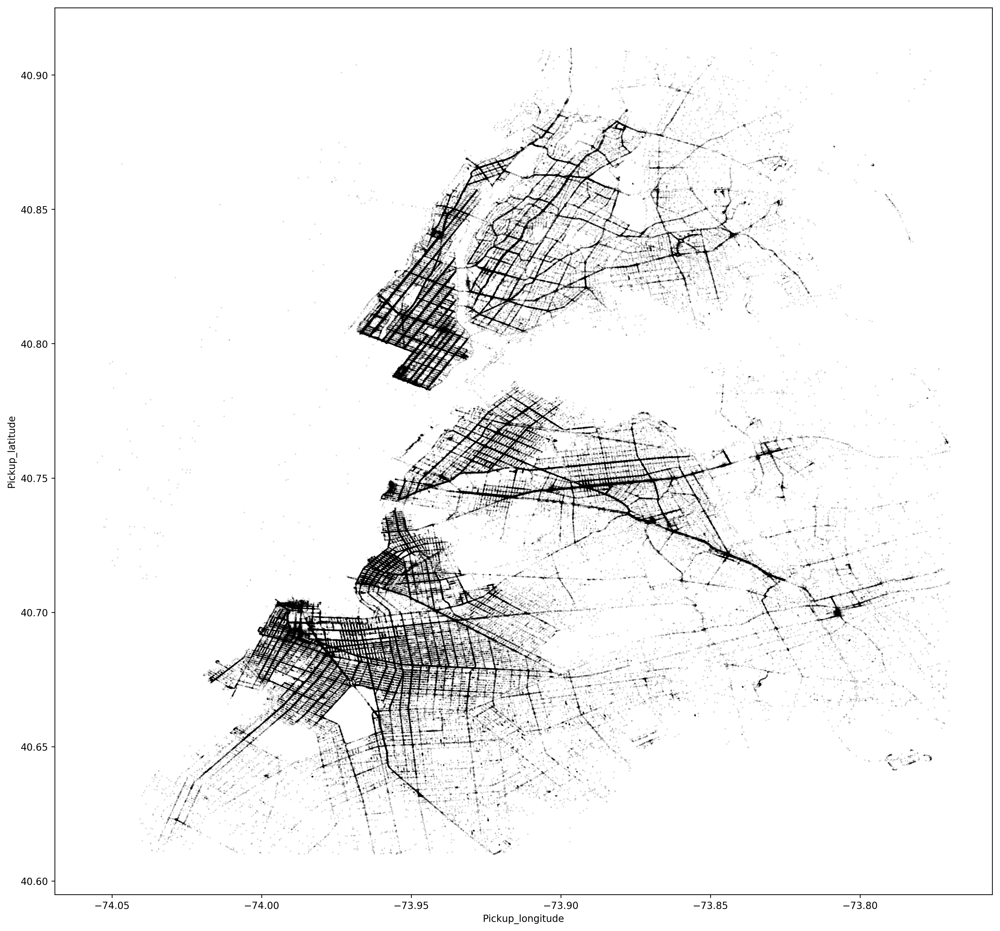

In [16]:
# Plot all pickup locations 
df.plot(kind='scatter', 
           x='Pickup_longitude', 
           y='Pickup_latitude',
           color='black',
           s=.02,
           alpha=.6)

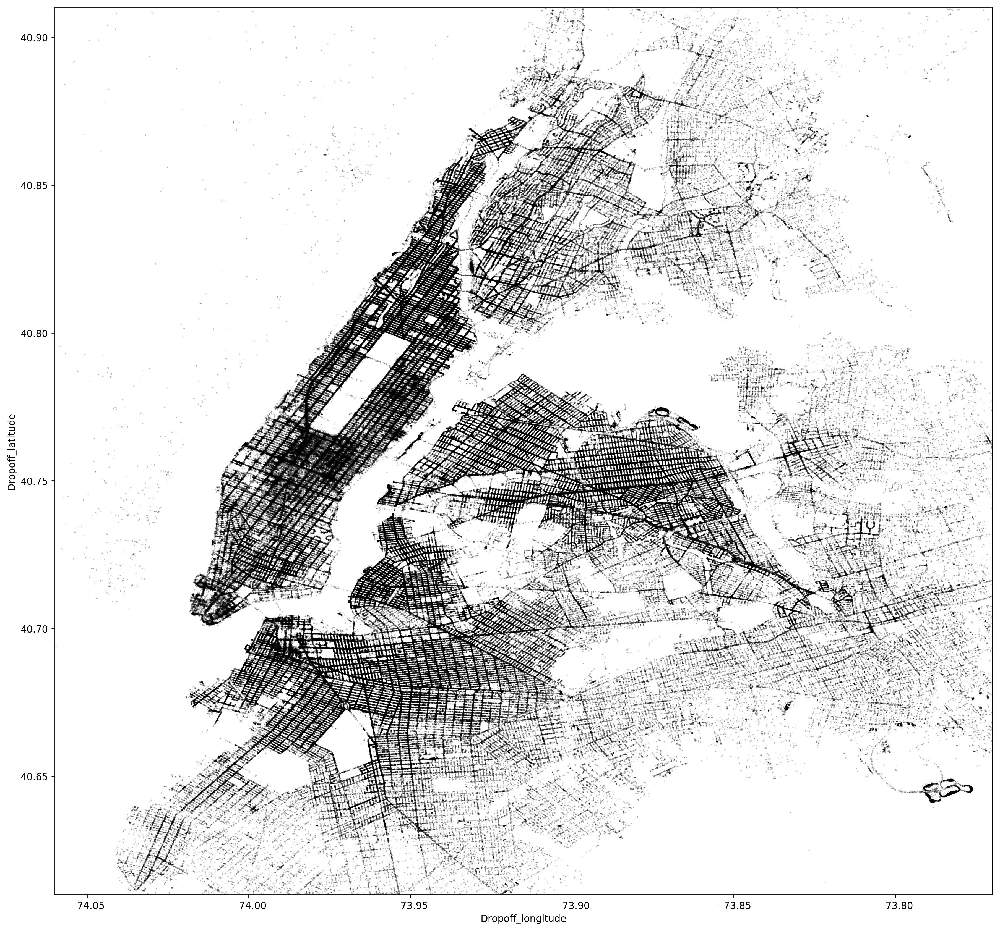

In [13]:
# Plot all dropoff locations
df.plot(kind='scatter', 
           x='Dropoff_longitude', 
           y='Dropoff_latitude',
           color='black',
           s=.02,
           alpha=.6)

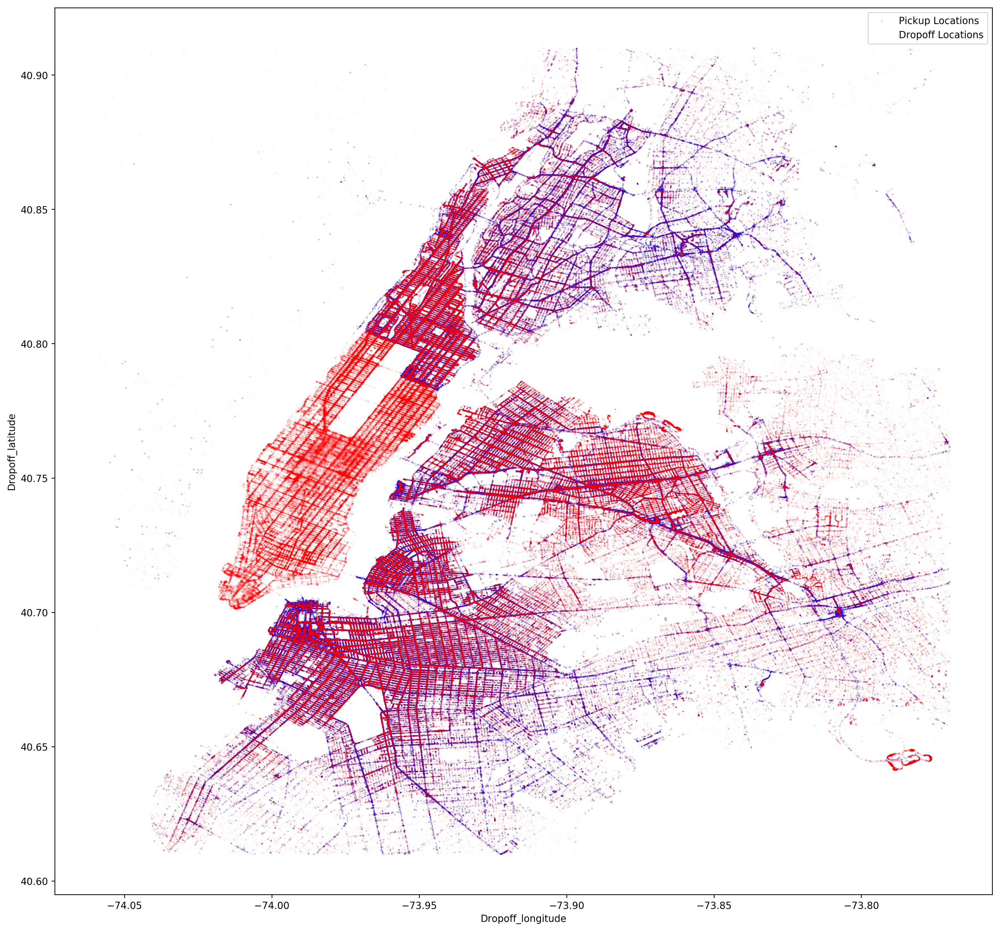

In [41]:
# Layer pickup and drop off locations on the same map
ax = df.plot(kind='scatter', 
           x='Pickup_longitude', 
           y='Pickup_latitude',
           color='blue',
           s=.02,
           alpha=1.0,
           label='Pickup Locations')

plot = df.plot(kind='scatter', 
           x='Dropoff_longitude', 
           y='Dropoff_latitude',
           color='red',
           s=.02,
           alpha=.2,
           label='Dropoff Locations',
           ax=ax)

fig = plot.get_figure()
fig.savefig("pickup_dropoff_redblue.png")

In [18]:
from matplotlib import cm
# cmap = cm.get_cmap('Spectral')

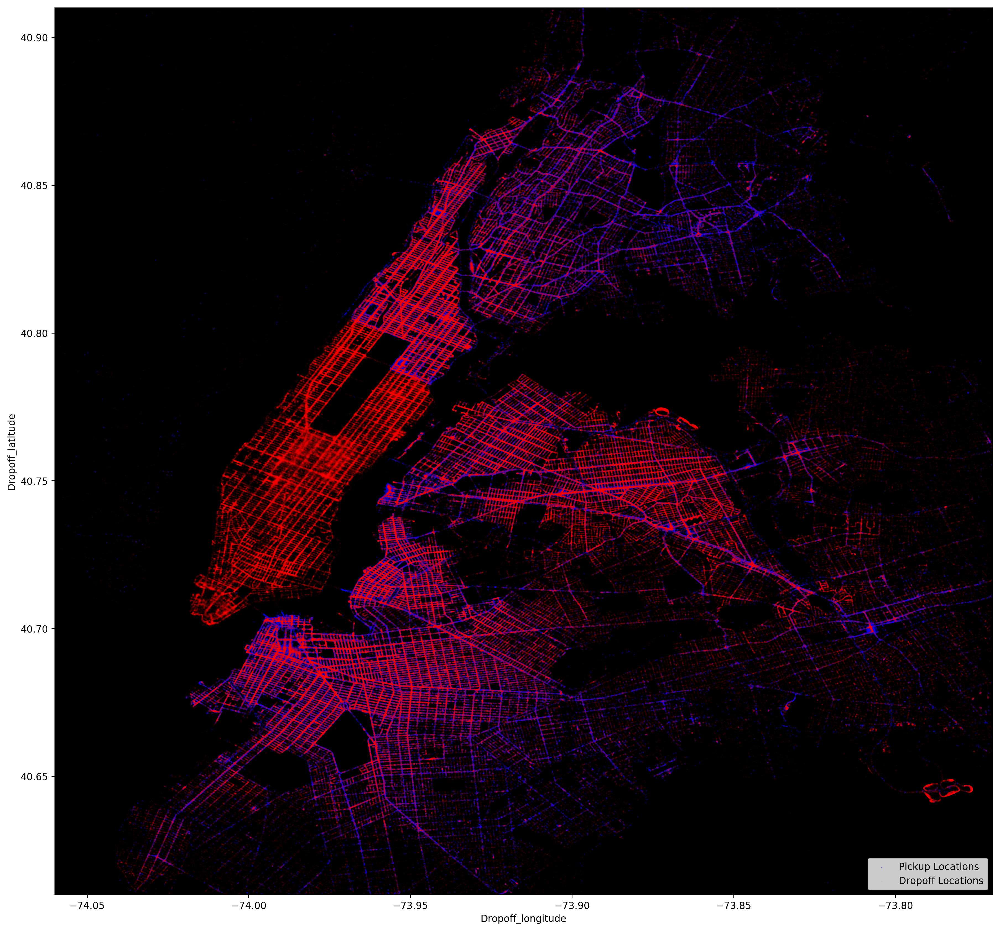

In [38]:
ax = df.plot(kind='scatter', 
           x='Pickup_longitude', 
           y='Pickup_latitude',
           color='blue',
           s=.02,
           alpha=1.0,
           label='Pickup Locations')

ax.set_facecolor('black')

df.plot(kind='scatter', 
           x='Dropoff_longitude', 
           y='Dropoff_latitude',
           color='red',
           s=.02,
           alpha=.2,
           label='Dropoff Locations',
           ax=ax)

### Plotting from geographic.csv file

In [43]:
def get_centroid(bound):
    cen_x=0.5*(max(bound[:,0]+min(bound[:,0])))
    cen_y=0.5*(max(bound[:,1]+min(bound[:,1])))
    return [cen_x,cen_y]

In [45]:
geo=pd.read_csv('../code/geographic.csv')

# Make new dataframe with x,y values
df_centroid={}

# for nbrhood in df:
#     boundary=geo[nbrhood].as_matrix().reshape(int(geo[nbrhood].size/2),2)
#     cent=get_centroid(boundary)
    
#     case={'cent_x':cent[0],'cent_y':cent[1]}
#     df_centroid[nbrhood]=case
    
#     plt.plot(boundary[:,0],boundary[:,1])
#     plt.scatter(cent[0],cent[1],color='r',s=0,)


In [51]:
import json
shapes_path = "../data/external/geojsons/nyc.geojson"
with open(shapes_path) as f:
    nyc = json.loads(f.read())

In [52]:
d = {}
for i in nyc["features"]:
    key = i["properties"]["neighborhood"]
    xs = []
    ys = []
    coords = {}
    for c in i["geometry"]["coordinates"][0]:
        coords = c
        xs += [c[0]]
        ys += [c[1]]
    
    d[key] = {"xs" : xs, "ys" : ys}

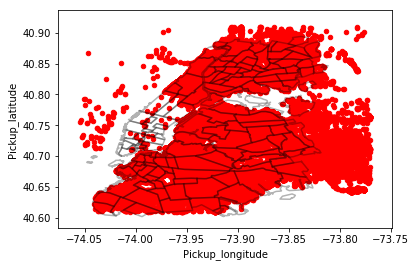

In [71]:
df.plot(kind='scatter', 
           x='Pickup_longitude', 
           y='Pickup_latitude',
           color='red')

for hood in d.keys():
    if (np.amin(d[hood]["xs"]) > -74.05) and (np.amax(d[hood]["xs"]) < -73.81)  \
    and (np.amax(d[hood]["ys"]) < 40.9) and (np.amin(d[hood]["ys"]) > 40.6):
        plt.plot(d[hood]["xs"],d[hood]["ys"],color="k",alpha=0.3)

# Plotting the taxi drivers old neighbourhood and new suggestions

In [14]:
# Taxi drivers old neighbourhood
taxi_driver_neighbourhood = df[df.pu_nbrhood == 'BX59']

In [15]:
taxi_driver_neighbourhood.shape

(2085, 22)

In [16]:
# Suggestioned neighbourhoods
suggested_neighbourhoods = ['BX06', 'BX17', 'BX29', 'BX37', 'MN04', 'MN06', 'MN09', 'MN40', 'QN18']
suggestions = df[df.pu_nbrhood.isin(suggested_neighbourhoods)]

In [17]:
suggestions.shape

(106763, 22)

In [18]:
# All other neighbourhoods
used_neighbourhoods = ['BX06', 'BX17', 'BX29', 'BX37', 'MN04', 'MN06', 'MN09', 'MN40', 'QN18', 'BX59']
all_others = df[~df.pu_nbrhood.isin(used_neighbourhoods)]

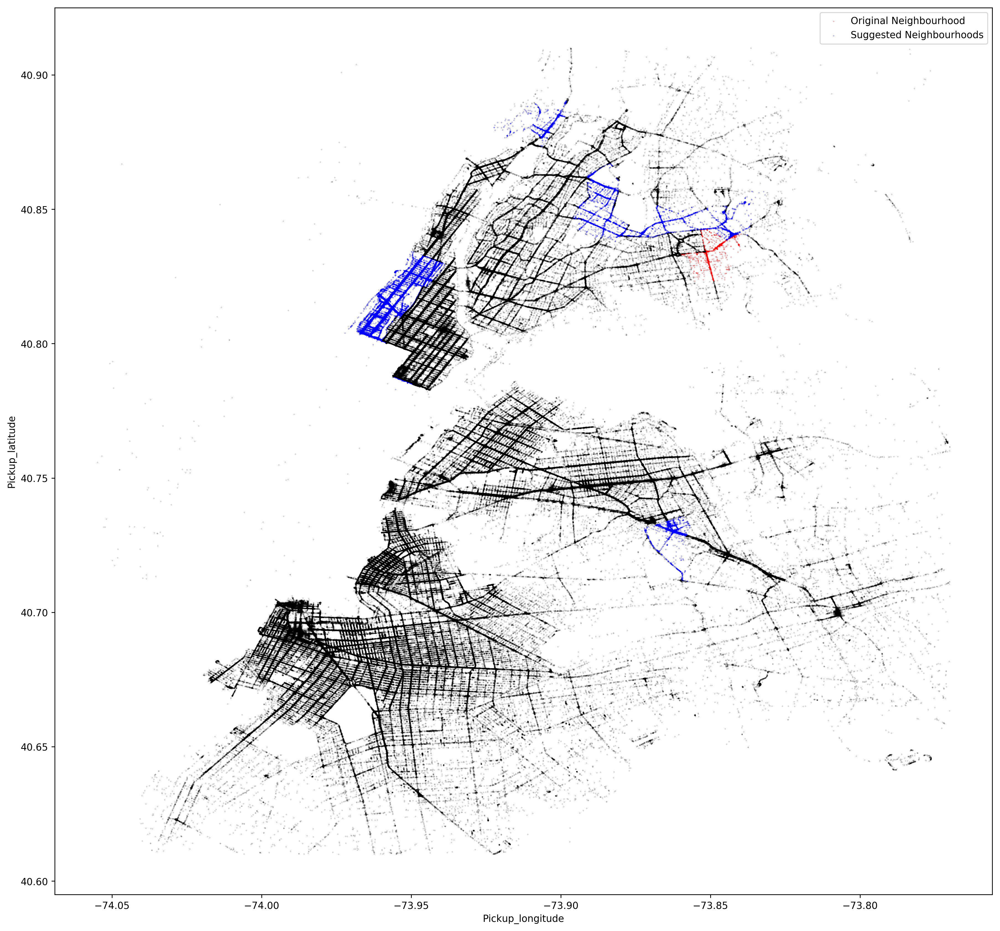

In [27]:
ax = taxi_driver_neighbourhood.plot(kind='scatter', 
                               x='Pickup_longitude', 
                               y='Pickup_latitude',
                               color='red',
                               s=.02,
                               alpha=1,
                               label = 'Original Neighbourhood')

ax = suggestions.plot(kind='scatter', 
                               x='Pickup_longitude', 
                               y='Pickup_latitude',
                               color='blue',
                               s=.02,
                               alpha=1,
                               ax = ax,
                               label = 'Suggested Neighbourhoods')

plot = all_others.plot(kind='scatter', 
                x='Pickup_longitude', 
                y='Pickup_latitude',
                color='black',
                s=.02,
                alpha=.6,
                ax = ax)

fig = plot.get_figure()
fig.savefig("neighbourhood_analysis.png")

In [12]:
df = df[df.Pickup_latitude > 40.68]

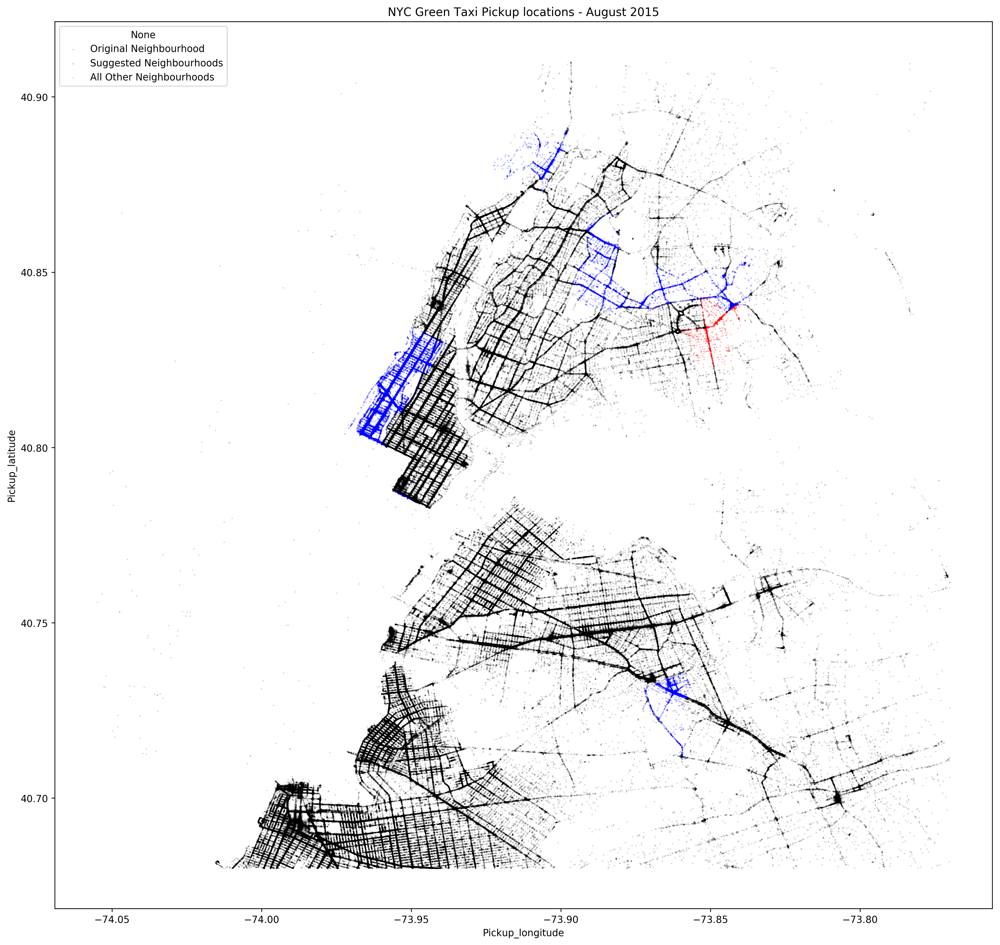

In [28]:
ax = taxi_driver_neighbourhood.plot(kind='scatter', 
                               x='Pickup_longitude', 
                               y='Pickup_latitude',
                               color='red',
                               s=.02,
                               alpha=1,
                               label = 'Original Neighbourhood')

ax = suggestions.plot(kind='scatter', 
                               x='Pickup_longitude', 
                               y='Pickup_latitude',
                               color='blue',
                               s=.02,
                               alpha=1,
                               ax = ax,
                               label = 'Suggested Neighbourhoods')

ax.legend(prop={'size': 10})

plot = all_others.plot(kind='scatter', 
                x='Pickup_longitude', 
                y='Pickup_latitude',
                color='black',
                s=.02,
                alpha=.6,
                label = 'All Other Neighbourhoods',
                ax = ax)

plt.title('NYC Green Taxi Pickup locations - August 2015')
plt.show()

# fig = plot.get_figure()
# fig.savefig("updated_neighbourhood_analysis.png")